In [ ]:
# set main directory name
dir = dirname(pwd());

In [1]:
using DifferentialEquations
using JumpProcesses
using Plots
# using PlotlyJS
using Statistics
using Distributions
using Random
using JLD2

using Optimization
using OptimizationOptimJL
# using BlackBoxOptim

using CSV
using DataFrames
using DelimitedFiles

# include own module with functionalities
include("functionalities.jl")

# set seed for reproducibility
Random.seed!(123);

# Compare metastasis processes
Using the exponential tumour growth model with the two different metastatic prcoesse to infer robustness for model missspecification.

In [2]:
beta = 0.5
m_basal = 0.01
m_size = 0.003

m_sigma = 0.03
m_order = 1.0

d_size = 0.001
d_metastasis = 0.002
θ = [beta, m_basal, m_size, m_sigma, m_order, d_size, d_metastasis]
p = (beta = beta, m_basal = m_basal, m_size = m_size, m_sigma = m_sigma, m_order = m_order, d_size = d_size, d_metastasis = d_metastasis)

(beta = 0.5, m_basal = 0.01, m_size = 0.003, m_sigma = 0.03, m_order = 1.0, d_size = 0.001, d_metastasis = 0.002)

## Data generation
First we generate data for each of the metastatic processes, but with the same tumour growth path. So simulations just differ in used intensity rate.

In [3]:
# function to simulate the datasets with joint underlying tumour growth
function simulate_joint_data(
    p::NamedTuple,
    TumorPath;
    npat = 200,
    S0=0.065,
    endtime=30.0,
    sigma = 0.1,
    rng = MersenneTwister(123),
    )
    timepoints = 0.0:1.0:endtime

    # initialize data frame
    cell_division_data = DataFrame(patient_id=Int64[], time=Float64[], tumor=Float64[], metastasis=Int64[], death=Int64[])
    proportional_data = DataFrame(patient_id=Int64[], time=Float64[], tumor=Float64[], metastasis=Int64[], death=Int64[])

    # loop over N simulations
    for i in 1:npat
        # get function for Tumor Growth ODE
        ODESol = TumorPath(S0, p; endtime=endtime)
        pat_id = i
        try
            sim_cell_division = single_MNR_simulation_cell_division(p, ODESol, S0=S0, endtime=endtime, rng=rng)
            sim_proportional = single_MNR_simulation_proportional_intensity(p, ODESol, S0=S0, endtime=endtime, rng=rng)
        catch e
            println("Simulation failed for patient $i")
            print(e)
            return ODESol
        end
        sim_cell_division = single_MNR_simulation_cell_division(p, ODESol, S0=S0, endtime=endtime, rng=rng)
        sim_proportional = single_MNR_simulation_proportional_intensity(p, ODESol, S0=S0, endtime=endtime, rng=rng)
        
        # get death times
        death_idc_proportional = findfirst(sim_proportional["Death"] .== 1)
        if !isnothing(death_idc_proportional)
            death_time_proportional = sim_proportional["t"][death_idc_proportional]
            if death_time_proportional > endtime
                death_time_proportional = endtime
            end
        else
            death_time_proportional = endtime
        end
        death_idc_cell_division = findfirst(sim_cell_division["Death"] .== 1)
        if !isnothing(death_idc_cell_division)
            death_time_cell_division = sim_cell_division["t"][death_idc_cell_division]
            if death_time_cell_division > endtime
                death_time_cell_division = endtime
            end
        else
            death_time_cell_division = endtime
        end
        times_proportional = vcat(timepoints[timepoints .< death_time_proportional], death_time_proportional)
        times_cell_division = vcat(timepoints[timepoints .< death_time_cell_division], death_time_cell_division)
        for t in times_proportional
            t_idc = findall(sim_proportional["t"] .<= t)[end]
            tumor_size = rand(Normal(ODESol(t)[1], ODESol(t)[1]*sigma))
            push!(proportional_data, (pat_id, t, tumor_size, sim_proportional["N"][t_idc], sim_proportional["Death"][t_idc]))
        end
        for t in times_cell_division
            t_idc = findall(sim_cell_division["t"] .<= t)[end]
            tumor_size = rand(Normal(ODESol(t)[1], ODESol(t)[1]*sigma))
            push!(cell_division_data, (pat_id, t, tumor_size, sim_cell_division["N"][t_idc], sim_cell_division["Death"][t_idc]))
        end
    end

    return proportional_data, cell_division_data
end

simulate_joint_data (generic function with 1 method)

In [4]:
# get exponential tumour growth
function expgrowth!(du, u, p, t)
    du[1] = p[1]* u[1]
end

function TumorPath(S0, p; endtime=30.0)
    prob = ODEProblem(expgrowth!, [S0], (0.0, endtime), [p.beta])
    sol = solve(prob, Tsit5(), reltol=1e-8, abstol=1e-8)
    return sol
end

TumorPath (generic function with 1 method)

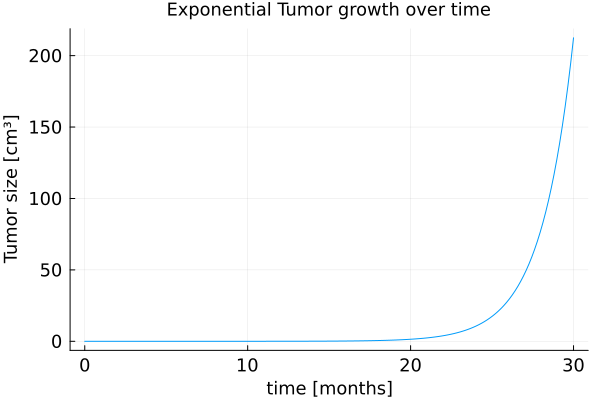

In [5]:
ode_sol = TumorPath(0.065, p; endtime=30.0)
plot(ode_sol.t, [ode_sol.u[i][1]/1000 for i in eachindex(ode_sol.t)], label=false, xlabel="time [months]", ylabel="Tumor size [cm³]", title="Exponential Tumor growth over time")
plot!(tickfontsize=12, legenfontsize=12, guidefontsize=12, titlefontsize=12)
# save figures
# savefig("figures/ode_paper/pure_exponential_growth.pdf")

In [6]:
radius = (ode_sol.u[end][1]*3/(4*π))^(1/3)

37.018088749010886

$\beta=0.45$ corresponds to an endsize of the tumour of diameter 4.5cm. We could also opt for $\beta=0.42$ for an endsize diameter of 3.4cm or $\beta=0.5$ for a diameter of 7.4cm

In [30]:
# simulate data
proportional_data, cell_division_data = simulate_joint_data(p, TumorPath; npat=500, S0=0.065, endtime=30.0, rng=MersenneTwister(27));

In [14]:
# # # save data
# npat = 500
# data_path = joinpath(pwd(),"data/simplified_model/proportional_data_$(npat)_patients_$(θ).jld2")
# save(data_path, "proportional_data", proportional_data)

# data_path = joinpath(pwd(),"data/simplified_model/cell_division_data_$(npat)_patients_$(θ).jld2")
# save(data_path, "cell_division_data", cell_division_data)

In [3]:
# load data
npat = 500
data_path = joinpath(pwd(),"data/simplified_model/proportional_data_$(npat)_patients_$(θ).jld2")
proportional_data = load(data_path)["proportional_data"];

data_path = joinpath(pwd(),"data/simplified_model/cell_division_data_$(npat)_patients_$(θ).jld2")
cell_division_data = load(data_path)["cell_division_data"];

In [8]:
data_summary(proportional_data)

Dict{String, Real} with 10 entries:
  "Mean survival time:"          => 24.2302
  "Low Quantile survival time:"  => 21.3947
  "Mean metastasis at day 10:"   => 0.161943
  "Mean metastasis at death:"    => 2.3871
  "Mean tumor size at day 10:"   => 9.70422
  "High Quantile survival time:" => 27.6585
  "Maximal metastasis number:"   => 12
  "Mean metastasis at day 20:"   => 0.648019
  "Patients died:"               => 434
  "Maximum metastasis increase:" => 5

In [5]:
data_summary(cell_division_data)

Dict{String, Real} with 10 entries:
  "Mean survival time:"          => 24.1437
  "Low Quantile survival time:"  => 22.0002
  "Mean metastasis at day 10:"   => 0.521298
  "Mean metastasis at death:"    => 3.17371
  "Mean tumor size at day 10:"   => 9.63199
  "High Quantile survival time:" => 27.6126
  "Maximal metastasis number:"   => 11
  "Mean metastasis at day 20:"   => 2.15278
  "Patients died:"               => 426
  "Maximum metastasis increase:" => 4

In [ ]:
data_visualization(proportional_data)

In [ ]:
data_visualization(cell_division_data)

In [ ]:
visualize_data_trajectories(proportional_data)

In [ ]:
visualize_data_trajectories(cell_division_data)

## Visualize comparison

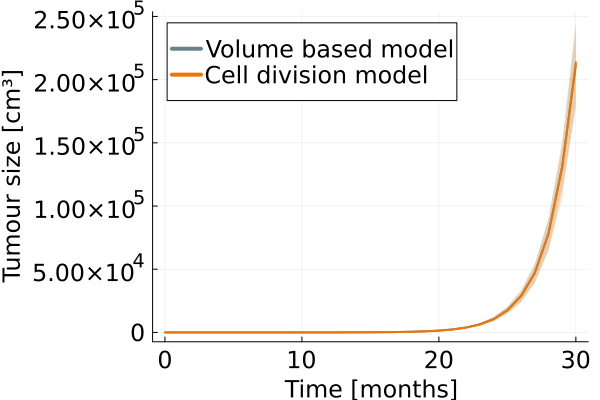

In [26]:
timepoints = 0.0:1.0:30.0
npat = 500

proportional_tumor_mean = []
proportional_tumor_low_ci = []
proportional_tumor_high_ci = []
cell_division_tumor_mean = []
cell_division_tumor_low_ci = []
cell_division_tumor_high_ci = []


for t in unique(timepoints)
    push!(proportional_tumor_mean, mean(proportional_data[proportional_data.time .== t, :tumor]))
    push!(proportional_tumor_low_ci, quantile(proportional_data[proportional_data.time .== t, :tumor], 0.05))
    push!(proportional_tumor_high_ci, quantile(proportional_data[proportional_data.time .== t, :tumor], 0.95))
    push!(cell_division_tumor_mean, mean(cell_division_data[cell_division_data.time .== t, :tumor]))
    push!(cell_division_tumor_low_ci, quantile(cell_division_data[cell_division_data.time .== t, :tumor], 0.05))
    push!(cell_division_tumor_high_ci, quantile(cell_division_data[cell_division_data.time .== t, :tumor], 0.95))
end

plt = plot(timepoints, proportional_tumor_mean, linewidth=2, ribbon=((proportional_tumor_mean-proportional_tumor_low_ci),proportional_tumor_high_ci-proportional_tumor_mean), color=:lightblue4, fillalpha=0.2, label="Volume based model")
plot!(plt, timepoints, cell_division_tumor_mean, linewidth=2, ribbon=((cell_division_tumor_mean-cell_division_tumor_low_ci),cell_division_tumor_high_ci-cell_division_tumor_mean), color=:darkorange2, fillalpha=0.2, label="Cell division model")
plot!(tickfontsize=16, legendfontsize=16, guidefontsize=16, titlefontsize=16)
plot!(xlabel="Time [months]", ylabel="Tumour size [cm³]")
# savefig("figures/ode_paper/model_comparison_tumor_size.pdf")

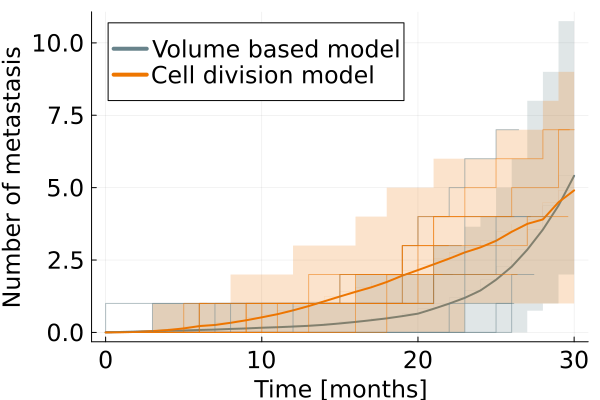

In [27]:
timepoints = 0.0:1.0:30.0
npat = 500

proportional_metastasis_mean = []
proportional_metastasis_low_ci = []
proportional_metastasis_high_ci = []
cell_division_metastasis_mean = []
cell_division_metastasis_low_ci = []
cell_division_metastasis_high_ci = []

for t in unique(timepoints)
    push!(proportional_metastasis_mean, mean(proportional_data[proportional_data.time .== t, :metastasis]))
    push!(proportional_metastasis_low_ci, quantile(proportional_data[proportional_data.time .== t, :metastasis], 0.05))
    push!(proportional_metastasis_high_ci, quantile(proportional_data[proportional_data.time .== t, :metastasis], 0.95))
    push!(cell_division_metastasis_mean, mean(cell_division_data[cell_division_data.time .== t, :metastasis]))
    push!(cell_division_metastasis_low_ci, quantile(cell_division_data[cell_division_data.time .== t, :metastasis], 0.05))
    push!(cell_division_metastasis_high_ci, quantile(cell_division_data[cell_division_data.time .== t, :metastasis], 0.95))
end
plt = plot()
plot!(plt,timepoints, proportional_metastasis_mean, linewidth=2, label="Volume based model", color=:lightblue4)
plot!(plt,timepoints, proportional_metastasis_mean, ribbon=((proportional_metastasis_mean-proportional_metastasis_low_ci),proportional_metastasis_high_ci-proportional_metastasis_mean), fillalpha=0.2, linewidth=0, label="", linetype=:steppre, color=:lightblue4)
plot!(plt,timepoints, cell_division_metastasis_mean, linewidth=2, label="Cell division model", color=:darkorange2)
plot!(plt, timepoints, cell_division_metastasis_mean, ribbon=((cell_division_metastasis_mean-cell_division_metastasis_low_ci),cell_division_metastasis_high_ci-cell_division_metastasis_mean), fillalpha=0.2, linewidth=0, linetype=:steppre, label="", color=:darkorange2)

# add some single metastasis trajectories
for i in sample(1:npat, 10, replace=false)
    plot!(plt, proportional_data[proportional_data.patient_id .== i, :time], 
        proportional_data[proportional_data.patient_id .== i, :metastasis], 
        color=:lightblue4, 
        linetype=:steppre,
        alpha=0.5,
        label="")
end
for i in sample(1:npat, 10, replace=false)
    plot!(plt, cell_division_data[cell_division_data.patient_id .== i, :time], 
        cell_division_data[cell_division_data.patient_id .== i, :metastasis], 
        color=:darkorange2, 
        linetype=:steppre,
        alpha=0.5,
        label="")
end


plot!(tickfontsize=16, legendfontsize=16, guidefontsize=16, titlefontsize=16, legend=:topleft)
plot!(xlabel="Time [months]", ylabel="Number of metastasis")


In [28]:
savefig("figures/ode_paper/model_comparison_metastasis_trajectories.pdf")

"/home/vincent/PhD/Projects/method_project/second_model/figures/ode_paper/model_comparison_metastasis_trajectories.pdf"

In [30]:
npat = 500
proportional_death_lines = Vector{Any}(undef, npat)
cell_division_death_lines = Vector{Any}(undef, npat)

for i in 1:npat
    try
        proportional_death_index = findfirst(proportional_data[proportional_data.patient_id.== i, :].death .== 1)
        proportional_death_lines[i] = proportional_data[proportional_data.patient_id .== i, :][proportional_death_index, :]
        cell_division_death_index = findfirst(cell_division_data[cell_division_data.patient_id .== i, :].death .== 1)
        cell_division_death_lines[i] = cell_division_data[cell_division_data.patient_id .== i, :][cell_division_death_index, :]
    catch e
        proportional_death_lines[i] = proportional_data[proportional_data.patient_id .== i, :][end, :]
        cell_division_death_lines[i] = cell_division_data[cell_division_data.patient_id .== i, :][end, :]
    end
end


proportional_survivals = Vector{Any}(undef, npat)
cell_division_survivals = Vector{Any}(undef, npat)

for i in 1:npat
    proportional_survivals[i] = proportional_death_lines[i].time[1]
    cell_division_survivals[i] = cell_division_death_lines[i].time[1]
end

# Plot Kaplan-Meier curve for survivals

# sort by survival
proportional_survivals = sort(proportional_survivals)
cell_division_survivals = sort(cell_division_survivals)

# get survival probabilities
proportional_survival_probs = zeros(npat) 
cell_division_survival_probs = zeros(npat) 

for i in 1:npat
    proportional_survival_probs[i] = (npat - i + 1) / npat
    cell_division_survival_probs[i] = (npat - i + 1) / npat
end

# plot
plot(proportional_survivals, proportional_survival_probs, color=:lightblue4, linewidth=2, xlabel="Time", ylabel="Survival probability", label="Volume based model")
plot!(cell_division_survivals, cell_division_survival_probs, color=:darkorange2, linewidth=2, xlabel="Time [months]", ylabel="Survival probability", label="Cell division model")
plot!(tickfontsize=16, legendfontsize=16, guidefontsize=16, titlefontsize=16, legend=:bottomleft)
# savefig("figures/ode_paper/model_comparison_KM.pdf")


"/home/vincent/PhD/Projects/method_project/second_model/figures/ode_paper/model_comparison_KM.pdf"

## Inference
First we perform inference for the two models separately.

### Proportional model

In [9]:
include("ProportionalLikelihoods.jl")
import .ProportionalLikelihoods as PL

In [34]:
x0=[0.5, 0.02, 0.02, 0.002, 0.002]

betaOptim(x, p) = PL.TumorNegLogLikelihood(x[1], proportional_data, S0=0.065)
betaOptimFunc = OptimizationFunction(betaOptim, Optimization.AutoForwardDiff())
betaOptimProblem = OptimizationProblem(betaOptimFunc, [x0[1]], lb=zeros(1).+1e-4, ub=ones(1))
betaEst = solve(betaOptimProblem, LBFGS(), maxiters=10^4, maxtime=30.0)
println("Beta:", betaEst, "\n")

Beta:retcode: Success
u: [0.49999262300438946]
Final objective value:     38758.04988056935




In [35]:
metOptim(x, p) = PL.MetastasisNegLogLikelihood([betaEst[1], x[1], x[2]], proportional_data, S0=0.065)
metOptimFunc = OptimizationFunction(metOptim, Optimization.AutoForwardDiff())
metOptimProblem = OptimizationProblem(metOptimFunc, x0[2:3], lb=zeros(2).+1e-4, ub=ones(2))
metEst = solve(metOptimProblem, LBFGS(), maxiters=10^5)
println("Metastasis:", metEst, "\n")

Metastasis:retcode: Success
u: [0.012332409788989165, 0.003014251277483095]
Final objective value:     3446.241065940509




In [36]:
deathOptim(x, p) = PL.DeathNegLogLikelihood([betaEst[1], metEst[1], metEst[2], x[1], x[2]], proportional_data, S0=0.065)
deathOptimFunc = OptimizationFunction(deathOptim, Optimization.AutoForwardDiff())
deathOptimProblem = OptimizationProblem(deathOptimFunc, x0[4:5], lb=zeros(2).+1e-4, ub=ones(2))
deathEst = solve(deathOptimProblem, LBFGS(), maxiters=10^5, maxtime=300.0)
est_par = [betaEst[1], metEst[1], metEst[2], deathEst[1], deathEst[2]]

5-element Vector{Float64}:
 0.49999262300438946
 0.012332409788989165
 0.003014251277483095
 0.0009823845081460257
 0.004551317495295234

In [37]:
deathOptim(x, p) = PL.DeathNegLogLikelihood([betaEst[1], metEst[1], metEst[2], x[1], x[2]], proportional_data, S0=0.065)
deathOptimFunc = OptimizationFunction(deathOptim, Optimization.AutoForwardDiff())
deathOptimProblem = OptimizationProblem(deathOptimFunc, x0[4:5], lb=zeros(2).+1e-4, ub=ones(2))
deathEst = solve(deathOptimProblem, SAMIN(), maxiters=10^6, maxtime=300.0)
est_par = [betaEst[1], metEst[1], metEst[2], deathEst[1], deathEst[2]]

SAMIN results
NO CONVERGENCE: MAXEVALS exceeded

     Obj. value:        1370.26174

       parameter      search width
         0.00098           0.00000 
         0.00455           0.00000 


5-element Vector{Float64}:
 0.49999262300438946
 0.012332409788989165
 0.003014251277483095
 0.0009823831904221937
 0.004551392742360844

In [25]:
Optim(x, p) = PL.NegLogLikelihood(x, proportional_data, S0=0.065)
OptimFunc = OptimizationFunction(Optim, Optimization.AutoForwardDiff())
OptimProblem = OptimizationProblem(OptimFunc, x0, lb=zeros(5).+1e-4, ub=ones(5))
joint_est = solve(OptimProblem, LBFGS(), maxiters=10^6, maxtime=300.0)


u: 5-element Vector{Float64}:
 0.49996390051157347
 0.012329015273428175
 0.003015392398294117
 0.0009827242541826009
 0.0045512250537821245

## Sampling

In [18]:
using MCMCChains
using StatsPlots
include("functionalities.jl")
using HDF5

In [19]:
# load result hdf5 file
n_iter = 100000
n_chains = 4
result_path = joinpath(pwd(), "output/simplified_model/sampling_proportional_data_$(n_chains)chs_$(n_iter)it_$(θ).h5")
chain_dict = h5open(result_path, "r") do file
    read(file,)
end
chain = dict_to_chain(chain_dict, ["beta", "m_basal", "m_size", "d_size", "d_metastasis"], n_chains, n_iter)

Chains MCMC chain (100001×5×4 Array{Float64, 3}):

Iterations        = 1:1:100001
Number of chains  = 4
Samples per chain = 100001
parameters        = beta, m_basal, m_size, d_size, d_metastasis

Summary Statistics
    parameters      mean       std      mcse     ess_bulk     ess_tail      rh ⋯
        Symbol   Float64   Float64   Float64      Float64      Float64   Float ⋯

          beta    0.4999    0.0001    0.0000   14782.6186   15120.6710    1.00 ⋯
       m_basal    0.0094    0.0021    0.0001    6757.1535    3029.2220    1.00 ⋯
        m_size    0.0029    0.0005    0.0000    9242.2821    7780.0331    1.00 ⋯
        d_size    0.0010    0.0001    0.0000   10889.7745    9082.3969    1.00 ⋯
  d_metastasis    0.0044    0.0028    0.0000    7430.4860    6324.2056    1.00 ⋯
                                                               2 columns omitted

Quantiles
    parameters      2.5%     25.0%     50.0%     75.0%     97.5% 
        Symbol   Float64   Float64   Float64   Float64   Fl

In [20]:
burn_in = burn_in_from_geweke(chain)
if burn_in >= length(chain)
    burn_in = Int(floor(length(chain)/2))
end

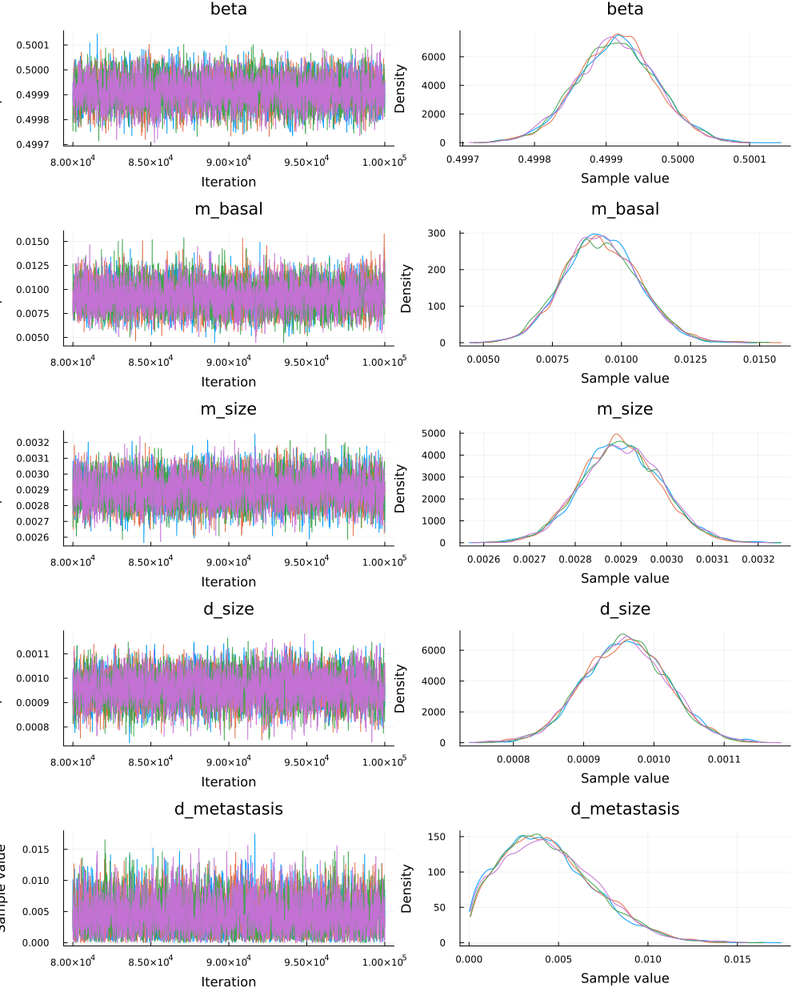

In [21]:
StatsPlots.plot(chain[burn_in:end])

# Cell Division model

In [8]:
include("CellDivisionLikelihoods.jl")
import .CellDivisionLikelihoods as CDL

In [27]:
Optim(x, p) = CDL.TumorNegLogLikelihood(x[1], cell_division_data, S0=0.065)
OptimFunc = OptimizationFunction(Optim, Optimization.AutoForwardDiff())
OptimProblem = OptimizationProblem(OptimFunc, [0.46], lb=zeros(1).+1e-4, ub=[1])
Est = solve(OptimProblem, LBFGS(), maxiters=10^5)
println("beta:", Est[1], "\n",)

beta:0.49997762397359913



In [28]:
metOptim(x, p) = CDL.MetastasisNegLogLikelihood([Est[1], x[1], 1], cell_division_data, S0=0.065)
metOptimFunc = OptimizationFunction(metOptim, Optimization.AutoForwardDiff())
metOptimProblem = OptimizationProblem(metOptimFunc, [0.1], lb=zeros(1).+1e-4, ub=ones(1))
metEst = solve(metOptimProblem, LBFGS(), maxiters=10^5)
println("Metastasis:", metEst, "\n")

Metastasis:retcode: Success
u: [0.029315036567856025]
Final objective value:     4911.12689336955




In [29]:
deathOptim(x, p) = CDL.DeathNegLogLikelihood([Est[1], metEst[1], 1.0, x[1], x[2]], cell_division_data, S0=0.065)
deathOptimFunc = OptimizationFunction(deathOptim, Optimization.AutoForwardDiff())
deathOptimProblem = OptimizationProblem(deathOptimFunc, [0.005, 0.005], lb=zeros(2).+1e-4, ub=ones(2))
deathEst = solve(deathOptimProblem, SAMIN(), maxiters=10^5)
est_par = [Est[1], metEst[1], 1.0, deathEst[1], deathEst[2]]

# print solutions
#println("True parameter is \n", true_par)
println("Estimated parameter is \n", est_par)

SAMIN results
==> Normal convergence <==
total number of objective function evaluations: 19751

     Obj. value:   1373.9591363955

       parameter      search width
         0.00096           0.00000 
         0.00140           0.00000 

Estimated parameter is 
[0.49997762397359913, 0.029315036567856025, 1.0, 0.0009600749129000342, 0.0014008990631084947]


In [95]:
# save estiamted parameter
save(joinpath(pwd(), "output/simplified_model/estimated_parameters_cell_division_$(θ).jld2"), "est_par", est_par)

## Sampling

In [50]:
using MCMCChains
using StatsPlots
include("functionalities.jl")
using HDF5

In [53]:
# load result hdf5 file
n_iter = 100000
n_chains = 4
result_path = joinpath(pwd(), "output/simplified_model/sampling_cell_division_data_$(n_chains)chs_$(n_iter)it_$(θ).h5")
chain_dict = h5open(result_path, "r") do file
    read(file,)
end
chain = dict_to_chain(chain_dict, ["beta", "m_sigma", "d_size", "d_metastasis"], n_chains, n_iter)

Chains MCMC chain (100001×4×4 Array{Float64, 3}):

Iterations        = 1:1:100001
Number of chains  = 4
Samples per chain = 100001
parameters        = beta, m_sigma, d_size, d_metastasis

Summary Statistics
    parameters      mean       std      mcse     ess_bulk     ess_tail      rh ⋯
        Symbol   Float64   Float64   Float64      Float64      Float64   Float ⋯

          beta    0.5000    0.0003    0.0000   22441.9728   19381.8593    1.00 ⋯
       m_sigma    0.0301    0.0008    0.0000   12988.4854   14284.9834    1.00 ⋯
        d_size    0.0010    0.0004    0.0000   18236.3673   12973.1475    1.00 ⋯
  d_metastasis    0.0014    0.0015    0.0000   15198.5978   10253.7994    1.00 ⋯
                                                               2 columns omitted

Quantiles
    parameters      2.5%     25.0%     50.0%     75.0%     97.5% 
        Symbol   Float64   Float64   Float64   Float64   Float64 

          beta    0.4999    0.5000    0.5000    0.5001    0.5002
       m_sigma  

In [54]:
burn_in = burn_in_from_geweke(chain)
if burn_in >= length(chain)
    burn_in = Int(floor(length(chain)/2))
end

50000

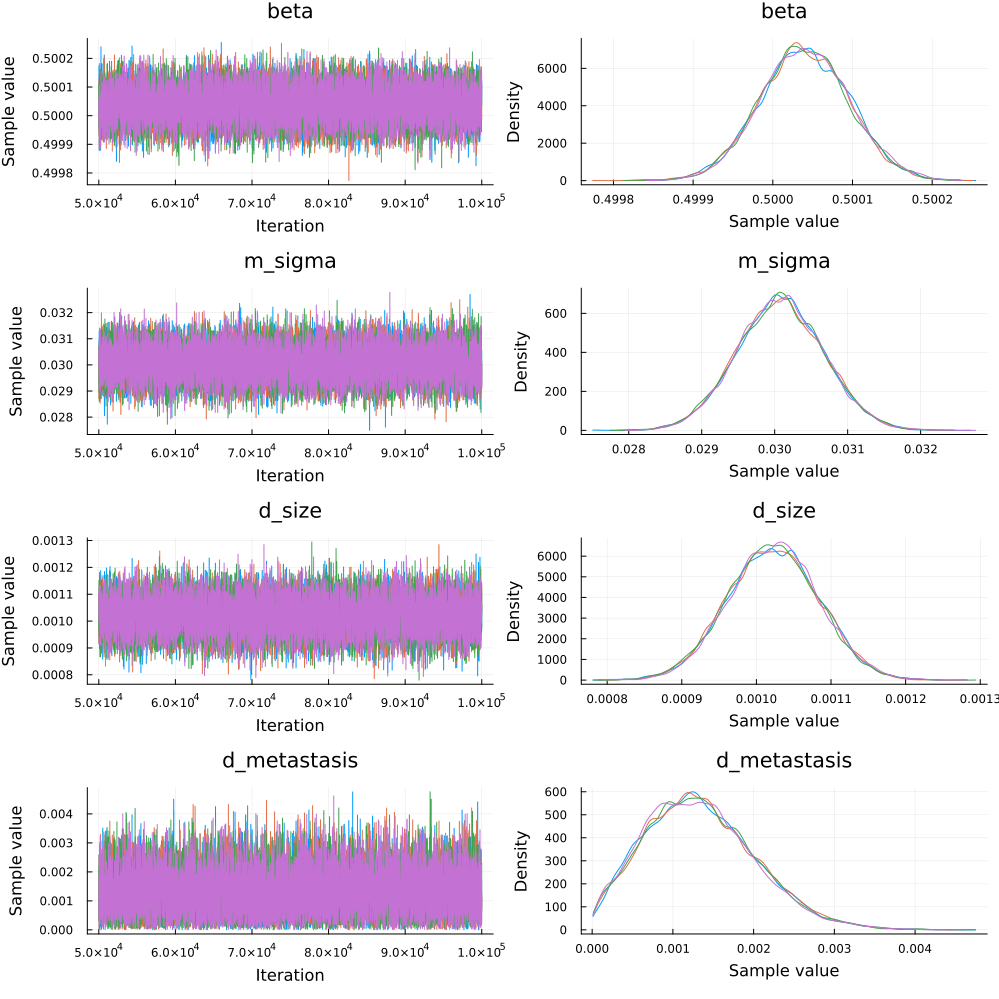

In [55]:
StatsPlots.plot(chain[burn_in:end])

# Compare Models
For the model comparison we need to run each model with the "wrong" data once.

In [4]:
prop_results = joinpath(pwd(), "output/results/proportional_optimization_10_starts_SAMIN_distributed.jld2")
prop_results = load(prop_results)["results"]["optimization_results"]
div_results = joinpath(pwd(), "output/results/cell_division_optimization_10_starts_SAMIN_distributed.jld2")
div_results = load(div_results)["results"]["optimization_results"];

In [5]:
div_prop_path = joinpath(pwd(), "output/results/cell_division_optimization_proportional_data_10_starts_SAMIN_distributed.jld2")
div_prop_results = load(div_prop_path)["results"]["optimization_results"];
div_par_names = ["beta", "m_sigma", "m_order", "d_size", "d_metastasis"];
prop_div_path = joinpath(pwd(), "output/results/proportional_optimization_cell_division_data_10_starts_SAMIN_distributed.jld2")
prop_div_results = load(prop_div_path)["results"]["optimization_results"];
prop_par_names = load(prop_div_path)["results"]["par_names"];

In [6]:
true_div = [beta, m_sigma, m_order, d_size, d_metastasis]
true_prop = [beta, m_basal, m_size, d_size, d_metastasis];

### First on proportional data set

In [10]:
x_div_prop = exp.(div_prop_results[1].value["parameter"]);
nllh_div_prop = CDL.NegLogLikelihood(x_div_prop, proportional_data, S0=0.065)

x_prop = exp.(prop_results[1].value["parameter"]);
nllh_prop = PL.NegLogLikelihood(x_prop, proportional_data, S0=0.065)

43581.183372561536

In [17]:
AIC_div_prop = 2*length(x_div_prop) + 2*nllh_div_prop
AIC_prop = 2*length(x_prop) + 2*nllh_prop

AIC_div_prop, AIC_prop

(88314.29367573172, 87172.36674512307)

The proportional model is way better on the proportional dataset.

In [17]:
x_prop

UndefVarError: UndefVarError: `x_prop` not defined

In [12]:
x_div_prop

5-element Vector{Float64}:
 0.4999142226844687
 0.01831563893078507
 1.0
 0.0009705656259898352
 0.003386990932955956

Interestingly the death parameters are not that different...

### Next on cell division data set

In [11]:
x_prop_div = exp.(prop_div_results[1].value["parameter"]);
nllh_prop_div = PL.NegLogLikelihood(x_prop_div, cell_division_data, S0=0.065);

x_div = exp.(div_results[1].value["parameter"]);
nllh_div = CDL.NegLogLikelihood(x_div, cell_division_data, S0=0.065);


In [19]:
AIC_prop_div = 2*length(x_prop_div) + 2*nllh_prop_div
AIC_div = 2*length(x_div) + 2*nllh_div

AIC_prop_div, AIC_div

(90858.48448006708, 90503.92949726008)

In [20]:
nllh_prop_div, nllh_div

(45424.24224003354, 45246.96474863004)

Interestingly, the correct model is still better than the incorrect model, but by less of a margin than above!!!

Maybe because the more degree of freedom allows the proportional model to mimic the other model a bit.

### Model fits

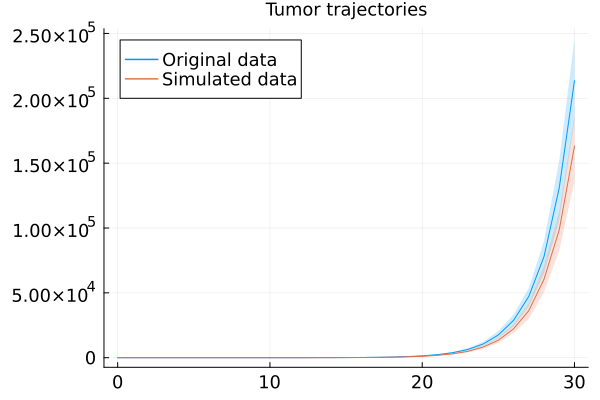

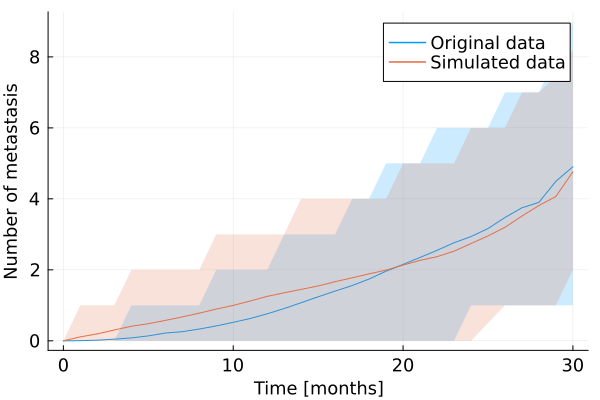

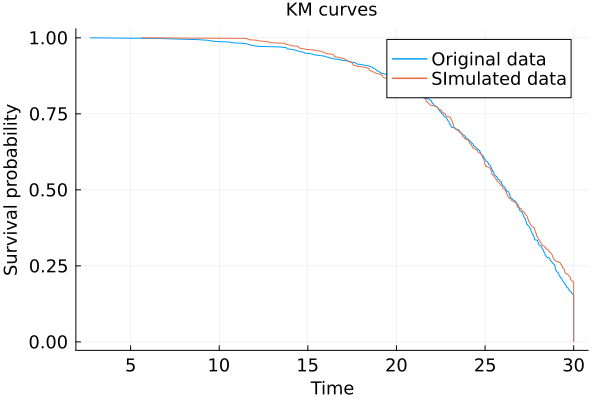

Original data 

Dict{String, Real}("Mean survival time:" => 24.143723579172015, "Low Quantile survival time:" => 22.000202002015055, "Mean metastasis at day 10:" => 0.5212981744421906, "Mean metastasis at death:" => 3.1737089201877935, "Mean tumor size at day 10:" => 9.631986513536992, "High Quantile survival time:" => 27.612595575072085, "Maximal metastasis number:" => 11, "Mean metastasis at day 20:" => 2.1527777777777777, "Patients died:" => 426, "Maximum metastasis increase:" => 4)

 Simulated data

Dict{String, Real}("Mean survival time:" => 23.988977667493796, "Low Quantile survival time:" => 21.624499999999994, "Mean metastasis at day 10:" => 0.9979959919839679, "Mean metastasis at death:" => 3.002481389578164, "Mean tumor size at day 10:" => 7.427386637386057, "High Quantile survival time:" => 27.470999999999997, "Maximal metastasis number:" => 10, "Mean metastasis at day 20:" => 2.1334894613583137, "Patients died:" => 403, "Maximum metastasis increase:" => 4)


(Plot{Plots.GRBackend() n=2}, Plot{Plots.GRBackend() n=2}, Plot{Plots.GRBackend() n=2})

In [16]:
#create named tuple of parameter names and values
par_prop_div = NamedTuple{Tuple(Symbol.(prop_par_names))}(x_prop_div)
plt1, plt2, plt3 = visualize_model_fit(cell_division_data, par_prop_div, tumor_model="exponential", metastatic_model="proportional_intensity")

In [17]:
savefig(plt2, "figures/ode_paper/model_fit_proportional_model_cell_division_data.pdf")

"/home/vincent/PhD/Projects/method_project/second_model/figures/ode_paper/model_fit_proportional_model_cell_division_data.pdf"

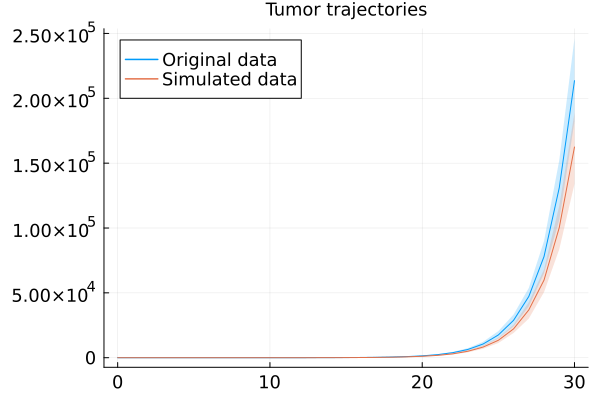

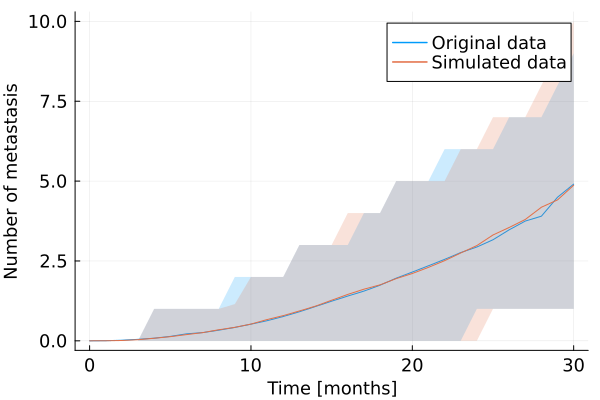

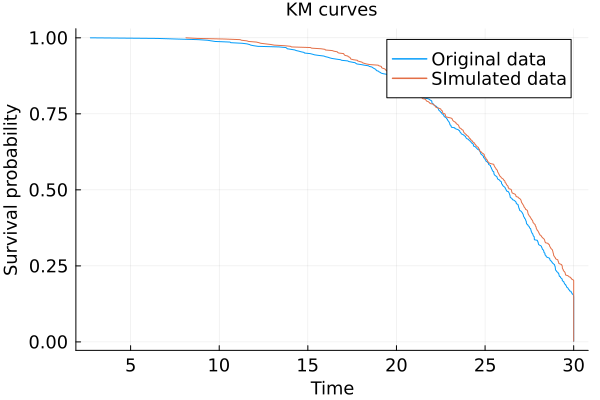

Original data 

Dict{String, Real}("Mean survival time:" => 24.143723579172015, "Low Quantile survival time:" => 22.000202002015055, "Mean metastasis at day 10:" => 0.5212981744421906, "Mean metastasis at death:" => 3.1737089201877935, "Mean tumor size at day 10:" => 9.631986513536992, "High Quantile survival time:" => 27.612595575072085, "Maximal metastasis number:" => 11, "Mean metastasis at day 20:" => 2.1527777777777777, "Patients died:" => 426, "Maximum metastasis increase:" => 4)

 Simulated data

Dict{String, Real}("Mean survival time:" => 24.170655820730172, "Low Quantile survival time:" => 21.46825324177297, "Mean metastasis at day 10:" => 0.5240963855421686, "Mean metastasis at death:" => 3.293233082706767, "Mean tumor size at day 10:" => 7.39447386848214, "High Quantile survival time:" => 27.61970302740118, "Maximal metastasis number:" => 11, "Mean metastasis at day 20:" => 2.108045977011494, "Patients died:" => 399, "Maximum metastasis increase:" => 4)


(Plot{Plots.GRBackend() n=2}, Plot{Plots.GRBackend() n=2}, Plot{Plots.GRBackend() n=2})

In [18]:
#create named tuple of parameter names and values
par_div = NamedTuple{Tuple(Symbol.(div_par_names))}(x_div)
plt1, plt2, plt3 = visualize_model_fit(cell_division_data, par_div, tumor_model="exponential", metastatic_model="cell_division")

In [19]:
savefig(plt2, "figures/ode_paper/model_fit_cell_division_model_cell_division_data.pdf")

"/home/vincent/PhD/Projects/method_project/second_model/figures/ode_paper/model_fit_cell_division_model_cell_division_data.pdf"

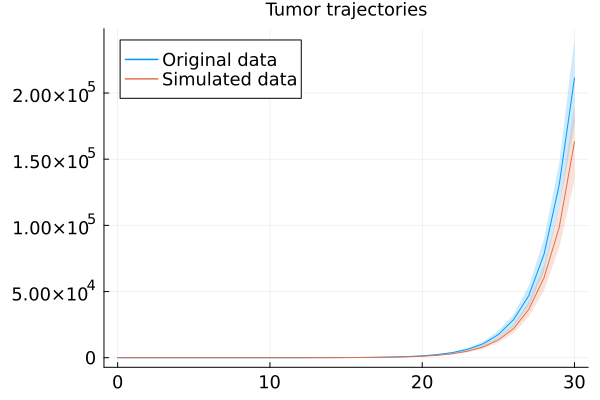

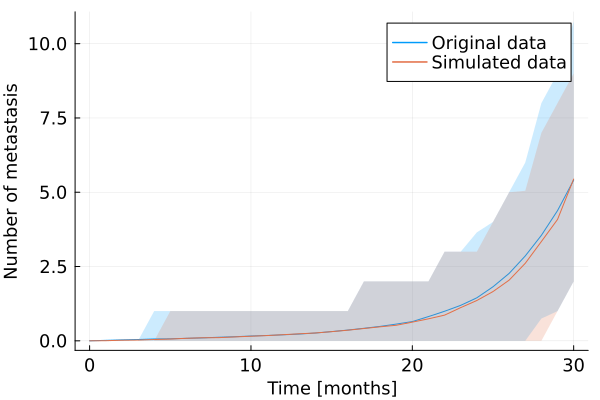

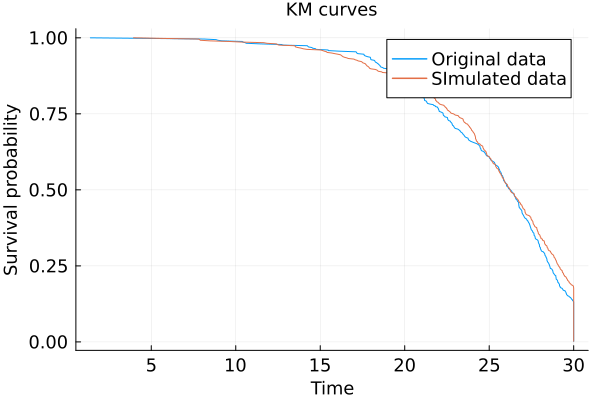

Original data 

Dict{String, Real}("Mean survival time:" => 24.230191244239627, "Low Quantile survival time:" => 21.394749999999995, "Mean metastasis at day 10:" => 0.16194331983805668, "Mean metastasis at death:" => 2.3870967741935485, "Mean tumor size at day 10:" => 9.704216882916128, "High Quantile survival time:" => 27.658499999999997, "Maximal metastasis number:" => 12, "Mean metastasis at day 20:" => 0.6480186480186481, "Patients died:" => 434, "Maximum metastasis increase:" => 5)

 Simulated data

Dict{String, Real}("Mean survival time:" => 24.132138349514566, "Low Quantile survival time:" => 21.83049999999999, "Mean metastasis at day 10:" => 0.15415821501014199, "Mean metastasis at death:" => 2.0436893203883497, "Mean tumor size at day 10:" => 7.4264683621959, "High Quantile survival time:" => 27.664499999999997, "Maximal metastasis number:" => 12, "Mean metastasis at day 20:" => 0.62877030162413, "Patients died:" => 412, "Maximum metastasis increase:" => 6)


(Plot{Plots.GRBackend() n=2}, Plot{Plots.GRBackend() n=2}, Plot{Plots.GRBackend() n=2})

In [20]:
x_prop = exp.(prop_results[1].value["parameter"]);
par_prop = NamedTuple{Tuple(Symbol.(prop_par_names))}(x_prop)
plt1, plt2, plt3 = visualize_model_fit(proportional_data, par_prop, tumor_model="exponential", metastatic_model="proportional_intensity")

In [21]:
savefig(plt2, "figures/ode_paper/model_fit_proportional_model_proportional_data.pdf")

"/home/vincent/PhD/Projects/method_project/second_model/figures/ode_paper/model_fit_proportional_model_proportional_data.pdf"

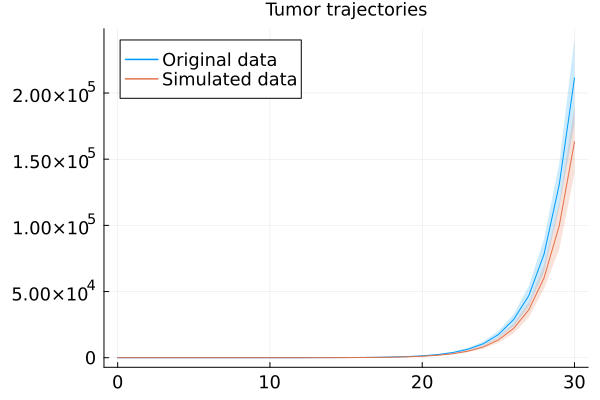

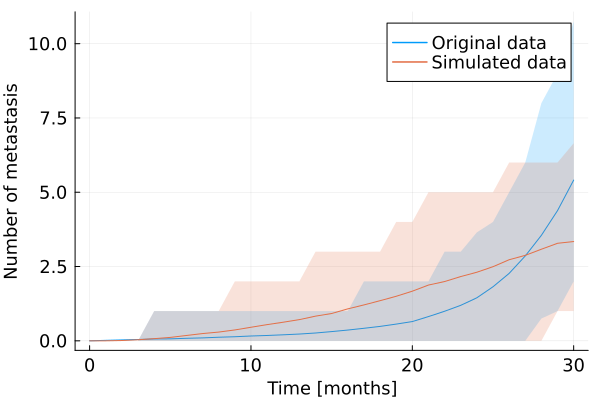

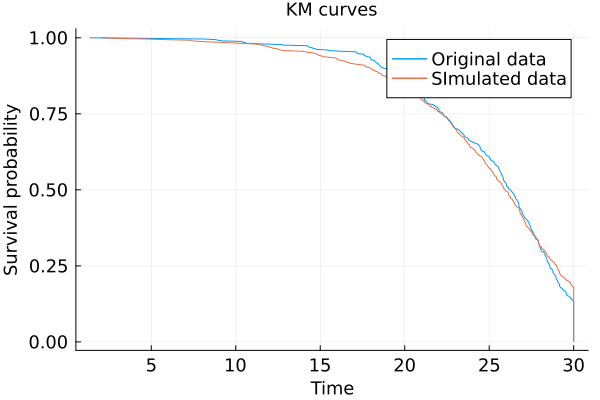

Original data 

Dict{String, Real}("Mean survival time:" => 24.230191244239627, "Low Quantile survival time:" => 21.394749999999995, "Mean metastasis at day 10:" => 0.16194331983805668, "Mean metastasis at death:" => 2.3870967741935485, "Mean tumor size at day 10:" => 9.704216882916128, "High Quantile survival time:" => 27.658499999999997, "Maximal metastasis number:" => 12, "Mean metastasis at day 20:" => 0.6480186480186481, "Patients died:" => 434, "Maximum metastasis increase:" => 5)

 Simulated data

Dict{String, Real}("Mean survival time:" => 23.550154088527414, "Low Quantile survival time:" => 21.0925284588753, "Mean metastasis at day 10:" => 0.45621181262729127, "Mean metastasis at death:" => 2.6067961165048543, "Mean tumor size at day 10:" => 7.391119956626322, "High Quantile survival time:" => 27.178167945282155, "Maximal metastasis number:" => 9, "Mean metastasis at day 20:" => 1.6706730769230769, "Patients died:" => 412, "Maximum metastasis increase:" => 3)


(Plot{Plots.GRBackend() n=2}, Plot{Plots.GRBackend() n=2}, Plot{Plots.GRBackend() n=2})

In [22]:
x_div_prop = exp.(div_prop_results[1].value["parameter"]);
par_div_prop = NamedTuple{Tuple(Symbol.(div_par_names))}(x_div_prop)
plt1, plt2, plt3 = visualize_model_fit(proportional_data, par_div_prop, tumor_model="exponential", metastatic_model="cell_division")

In [23]:
savefig(plt2, "figures/ode_paper/model_fit_cell_division_model_proportional_data.pdf")

"/home/vincent/PhD/Projects/method_project/second_model/figures/ode_paper/model_fit_cell_division_model_proportional_data.pdf"

From the model fits, cell division model looks better except for the KM curves. So it could only be that that is dominating the metastasis likelihood and therefore this difference shows up, although emtastasis processes are closer in the second model.

### Where does the difference in negative log-likelihood occur

In [23]:
x_div

5-element Vector{Float64}:
 0.49997762397359913
 0.029315036567855737
 1.0
 0.0009600747673383611
 0.0014009051905570183

In [24]:
x_prop_div

5-element Vector{Float64}:
 0.49997762397359913
 0.09572152631954406
 0.001228642331381867
 0.0009600898391967595
 0.0014004403155532972

In [25]:
x_prop

5-element Vector{Float64}:
 0.4999634577279166
 0.012330663665900134
 0.0030153582683008404
 0.0009827300652101737
 0.004551181052288507

In [26]:
PL.DeathNegLogLikelihood(x_prop_div, cell_division_data, S0=0.065)

1373.9597528766785

In [27]:
PL.NumericDeathNegLogLikelihood(x_prop_div, cell_division_data, S0=0.065)

1373.9597529077148

In [28]:
CDL.DeathNegLogLikelihood(x_div, cell_division_data, S0=0.065)

1373.9591363956208

In [29]:
CDL.NumericDeathNegLogLikelihood(x_div, cell_division_data, S0=0.065)

1422.91627930059

In [30]:
CDL.FGDeathNegLogLikelihood(x_div, cell_division_data, S0=0.065)

1422.91627930059

In [31]:
CDL.DeathNegLogLikelihood(true_div, cell_division_data, S0=0.065), CDL.NumericDeathNegLogLikelihood(true_div, cell_division_data, S0=0.065), CDL.FGDeathNegLogLikelihood(true_div, cell_division_data, S0=0.065)

(1374.838707404776, 1426.540243466441, 1426.540243466441)

We see the death likelihood of the one is far less, although it is the wrong model for the data. Also we see a difference between numeric and analytical likelihoods in the cell-division model, which we need to investigate into, since both numerical schemes agree against the analytical. (Not the maybe missing m! in the anlytical solution).

But it does not seem that this is the issue with the difference to the proportional model likelihood.

In [32]:
PL.DeathNegLogLikelihood(x_div, cell_division_data, S0=0.065)

1373.9253992034494

In [33]:
PL.DeathNegLogLikelihood(x_div, proportional_data, S0=0.065)

1372.231832239661

In [34]:
PL.DeathNegLogLikelihood(x_prop, cell_division_data, S0=0.065)

1380.244349566389

It is more a general observation, that the proportional model negative log-likelihood is way smaller than the cell division model one. Regardless of parameter and dataset combination.

Is there an implementation error?

Also for the same model and data set, exchanging the parameter vector does not change too much. I guess this is because death parameter are estimated nearly to the same values and only metastasis parameters differ substantially, but they don't have such a big impact on the deathlikelihood, although they should have more than just this.

The cell division death neg log-likelihood and total neg log-likelihood is better for the proportional dataset? This seems not correct somehow. Do simulation and likelihood really match in this case?

One should not compare across datasets, since datapoint number, dynamics, number of events and so on highly influence the likelihood...

In [35]:
PL.DeathNegLogLikelihood([0.5, 0.01, 0.01, x_prop[4:5]...], proportional_data, S0=0.065), PL.DeathNegLogLikelihood([0.5, 0.8, 0.0001, x_prop[4:5]...], proportional_data, S0=0.065)

(1370.253155425916, 1370.3716438633355)

In [36]:
PL.NumericDeathNegLogLikelihood([0.5, 0.01, 0.01, x_prop[4:5]...], proportional_data, S0=0.065), PL.NumericDeathNegLogLikelihood([0.5, 0.8, 0.0001, x_prop[4:5]...], proportional_data, S0=0.065)

(1370.253155426239, 1370.3716441368454)

Metastasis parameter don't have any influence on the death neg log-likelihood. (I wodner whether this is okay..., normally they come up in the formula. But it seems that that part is just really dominated by the death part...).

In [37]:
CDL.DeathNegLogLikelihood([0.5, 0.001, 0.001, x_div[4:5]...], cell_division_data, S0=0.065), CDL.DeathNegLogLikelihood([0.5, 5.0, 5.0, x_div[4:5]...], cell_division_data, S0=0.065)

(1206.20827620519, 2045.6816493906206)

In [38]:
CDL.NumericDeathNegLogLikelihood([0.5, 0.001, 0.001, x_div[4:5]...], cell_division_data, S0=0.065), CDL.NumericDeathNegLogLikelihood([0.5, 5.0, 5.0, x_div[4:5]...], cell_division_data, S0=0.065)

(1423.261843740878, 1421.5946050681803)

Metastasis parameters have completely no influence on the death likelihood in the analytical case (they don't show up in the formula, since I internally fixed m_order and m_sigma cancels out). But inaccuracies in the numerical case may explain this small difference.

In [39]:
PL.MetastasisNegLogLikelihood(x_prop_div, cell_division_data, S0=0.065)

5088.403768291974

In [40]:
CDL.MetastasisNegLogLikelihood(x_div, cell_division_data, S0=0.065)

4911.12689336955

The metatasis likelihood contribution favours the correct model, but the difference is smaller than in the death likelihood contributio nand therefore dominated.

In [41]:
function TumorGrowth(
    t, 
    S0::Real,
    beta::Real
    )
    return S0 * exp(beta * t)
end

function DivDeathNllh_df(
    θ::Vector{<:Real}, 
    data; 
    S0::Real=0.065
)
    # Unpack parameters
    beta, m_sigma, m_order, = θ

    n_patients = data.patient_id[end]
    death_nllh_df = DataFrame(patient_id=Int64[], timepoint=Float64[], nllh=Float64[])
    for p in 1:n_patients
        patient_data = data[data.patient_id .== p, :]
        # Unpack data
        timepoints, Bt, Nt, Dt = [patient_data.time, 
            patient_data.tumor, 
            patient_data.metastasis,
            patient_data.death
        ]
        pat_ids = Int.(ones(length(timepoints)).*p) 
        # get X based on parameters
        St = TumorGrowth.(timepoints, S0, beta)

        # Initialize loglikelihood
        l = []

        # Loop over data points
        for i in eachindex(timepoints)

            if (i == 1)
                t = timepoints[i]
                t⁻ = 0.0
                Xt = [St[i], Nt[i], Dt[i]] #(this creates Vector{<:Real} so we need Int for the factorial function later)
                Yt = [Bt[i], Nt[i], Dt[i]]
                Xt⁻ = [S0, 0, 0]
            else
                # Set t, t⁻1
                t = timepoints[i]
                t⁻ = timepoints[i-1]

                # Set Xt, Yt, Xt⁻1
                Xt = [St[i], Nt[i], Dt[i]]
                Yt = [Bt[i], Nt[i], Dt[i]]
                Xt⁻ = [St[i-1], Nt[i-1], Dt[i-1]]
            end

            # likelihood is basically just the observation probability here.
            append!(l, -NaNMath.log(CDL.OnlyDeathProbability(t⁻, t, θ, Xt⁻, Xt, S0)))
        end
        append!(death_nllh_df, DataFrame(patient_id=pat_ids, timepoint=timepoints, nllh=l))
    end
    return death_nllh_df
end

function PropDeathNllh_df(
    θ::Vector{<:Real}, 
    data; 
    S0::Real=0.065
)
    # Unpack parameters
    beta, m_sigma, m_order, = θ

    n_patients = data.patient_id[end]
    death_nllh_df = DataFrame(patient_id=Int64[], timepoint=Float64[], nllh=Float64[])
    for p in 1:n_patients
        patient_data = data[data.patient_id .== p, :]
        # Unpack data
        timepoints, Bt, Nt, Dt = [patient_data.time, 
            patient_data.tumor, 
            patient_data.metastasis,
            patient_data.death
        ]
        pat_ids = Int.(ones(length(timepoints)).*p) 
        # get X based on parameters
        St = TumorGrowth.(timepoints, S0, beta)

        # Initialize loglikelihood
        l = []

        # Loop over data points
        for i in eachindex(timepoints)

            if (i == 1)
                t = timepoints[i]
                t⁻ = 0.0
                Xt = [St[i], Nt[i], Dt[i]] #(this creates Vector{<:Real} so we need Int for the factorial function later)
                Yt = [Bt[i], Nt[i], Dt[i]]
                Xt⁻ = [S0, 0, 0]
            else
                # Set t, t⁻1
                t = timepoints[i]
                t⁻ = timepoints[i-1]

                # Set Xt, Yt, Xt⁻1
                Xt = [St[i], Nt[i], Dt[i]]
                Yt = [Bt[i], Nt[i], Dt[i]]
                Xt⁻ = [St[i-1], Nt[i-1], Dt[i-1]]
            end

            # likelihood is basically just the observation probability here.
            append!(l, -NaNMath.log(PL.OnlyDeathProbability(t⁻, t, θ, Xt⁻, Xt, S0)))
        end
        append!(death_nllh_df, DataFrame(patient_id=pat_ids, timepoint=timepoints, nllh=l))
    end
    return death_nllh_df
end

PropDeathNllh_df (generic function with 1 method)

In [42]:
div_df = DivDeathNllh_df(x_div, cell_division_data)
prop_df = PropDeathNllh_df(x_prop_div, cell_division_data)

Row,patient_id,timepoint,nllh
,Int64,Float64,Float64
1,1,0.0,-0.0
2,1,1.0,0.000278089
3,1,2.0,0.000357069
4,1,3.0,0.00045848
5,1,4.0,0.000588694
6,1,5.0,0.000755889
7,1,6.0,0.00097057
8,1,7.0,0.00124622
9,1,8.0,0.00160016


In [43]:
diff_nllhs = div_df.nllh - prop_df.nllh 
diff_idxs = findall(diff_nllhs .> 0.1)

max_diff, max_diff_id = findmax(diff_nllhs)

(5.840987573102474e-5, 4692)

In [44]:
div_df[div_df.patient_id .== div_df[max_diff_id, :].patient_id, :]

Row,patient_id,timepoint,nllh
,Int64,Float64,Float64
1,178,0.0,-0.0
2,178,1.0,0.000278084
3,178,2.0,0.000357063
4,178,3.0,0.000458473
5,178,4.0,0.000588685
6,178,5.0,0.000755878
7,178,6.0,0.000970555
8,178,7.0,0.0012462
9,178,8.0,0.00160014


In [45]:
prop_df[prop_df.patient_id .== div_df[max_diff_id, :].patient_id, :]

Row,patient_id,timepoint,nllh
,Int64,Float64,Float64
1,178,0.0,-0.0
2,178,1.0,0.000278089
3,178,2.0,0.000357069
4,178,3.0,0.00045848
5,178,4.0,0.000588694
6,178,5.0,0.000755889
7,178,6.0,0.00097057
8,178,7.0,0.00124622
9,178,8.0,0.00160016


It seems as if dying is always quite unlikely, but why do we then die? I mean, I guess this is because of the $\lambda_D$ which might be really small. Still, suprising, that it is that unlikely...

I mean in the proportional model, survival gets more and more unlikely, since tumour size gets bigger and metastasis number increases. And then we die. But in the cell division likelihood we see weird jumps. Especially at that timepoint 26. Also on 18, 20, 22 which are all timepoints, where jumps occured...

In [46]:
test_pat_data = cell_division_data[div_df.patient_id .== div_df[max_diff_id, :].patient_id, :]

Row,patient_id,time,tumor,metastasis,death
,Int64,Float64,Float64,Int64,Int64
1,178,0.0,0.0528197,0,0
2,178,1.0,0.0987987,0,0
3,178,2.0,0.167926,0,0
4,178,3.0,0.26456,0,0
5,178,4.0,0.501878,0,0
6,178,5.0,0.57948,0,0
7,178,6.0,1.23003,0,0
8,178,7.0,2.09757,0,0
9,178,8.0,2.90645,0,0


In [47]:
t1 = 17.0
t2 = 18.0
beta = 0.5
m_sigma = 0.03
m_order = 1.0

m_basal = 0.01
m_size = 0.003

d_size = 0.001
d_metastasis = 0.002

S0 = 0.065
n = 4

4

In [48]:
-log(CDL.Phi(t1-1, t2-1, beta, d_size, d_metastasis, S0, n))

0.023814366627832158

In [49]:
-log(CDL.AnalyticSurvivalProbability1(t1, t2, beta, m_sigma, m_order, d_size, d_metastasis, S0, n))

0.029296358267295368

In [50]:
-log(CDL.Phi(t1+1, t2+1, beta, d_size, d_metastasis, S0, n+1))

0.036073482641957165

Normally they should not jump like this...

Maybe it is because of lambda_N or Lambda_N

In [51]:
CDL.LambdaN(t1, t2, beta, m_sigma, m_order, S0)

0.18935372411667645

In [52]:
values = [CDL.lambdaN(t, beta, m_sigma, m_order, S0) for t in t1:0.01:t2]
trapz(t1:0.01:t2, values)

0.18935372411667648

Okay, $\Lambda_N$ seems incorrect!

I had $\ln(2)^{k+1}$ but the +1 was incorrect there.

In [54]:
CDL.lambdaN(t2, beta, m_sigma, m_order, S0)

0.19476383052001006